In [43]:
# Import 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import date
sns.set()

# ML-Workflow
1. Buisness Goal
2. Get Data
3. Train-Test-Split
4. EDA
5. Feature Engineering
6. Train-Model
7. Model selection and optimization / Cross-validation and Hyperparameter optimization
8. Evaluate model on the test Data
9. Deployment


In [3]:
df = pd.read_csv("./data/Aquifer_Auser.csv", index_col=0, parse_dates=True)


In [4]:
# Train-Test-Split

train = df[:-365]
test = df[-365:]

In [19]:
train.head(1)

,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,...,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione
Date,,,,,,,,,,,,,,,,,,,,,
1998-05-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [31]:
test.tail(1)

,rf_Ga,rf_Po,rf_MS,rf_Or,rf_BM,rf_Pa,rf_Ca,rf_Cr,rf_TCA,rf_FV,...,T_MS,T_PM,T_LOB,V_POL,V_CC1,V_CC2,V_CSA,V_CSAL,Hy_MQ,Hy_P
Date,,,,,,,,,,,,,,,,,,,,,
2020-06-30,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,19.9,0.0,25.05,-7189.406533,-7847.9,-9183.433333,-6115.4,-3158.0,0.21,-1.05


In [23]:
df.columns

Index(['Rainfall_Gallicano', 'Rainfall_Pontetetto', 'Rainfall_Monte_Serra',
       'Rainfall_Orentano', 'Rainfall_Borgo_a_Mozzano', 'Rainfall_Piaggione',
       'Rainfall_Calavorno', 'Rainfall_Croce_Arcana',
       'Rainfall_Tereglio_Coreglia_Antelminelli',
       'Rainfall_Fabbriche_di_Vallico', 'Depth_to_Groundwater_LT2',
       'Depth_to_Groundwater_SAL', 'Depth_to_Groundwater_PAG',
       'Depth_to_Groundwater_CoS', 'Depth_to_Groundwater_DIEC',
       'Temperature_Orentano', 'Temperature_Monte_Serra',
       'Temperature_Ponte_a_Moriano', 'Temperature_Lucca_Orto_Botanico',
       'Volume_POL', 'Volume_CC1', 'Volume_CC2', 'Volume_CSA', 'Volume_CSAL',
       'Hydrometry_Monte_S_Quirico', 'Hydrometry_Piaggione'],
      dtype='object')

In [25]:
train.isna().sum()

rf_Ga       2859
rf_Po       2859
rf_MS       2865
rf_Or       2859
rf_BM       2859
rf_Pa       3224
rf_Ca       2859
rf_Cr       2859
rf_TCA      2859
rf_FV       2859
dtG_LT2     3352
dtG_SAL     3609
dtG_PAG     4347
dtG_CoS     3832
dtG_DIEC    4783
T_Or           0
T_MS           0
T_PM           0
T_LOB          0
V_POL       2494
V_CC1       2494
V_CC2       2494
V_CSA       2494
V_CSAL      2494
Hy_MQ        913
Hy_P        2033
dtype: int64

In [26]:
test.isna().sum()

rf_Ga         0
rf_Po         0
rf_MS         0
rf_Or         0
rf_BM         0
rf_Pa         0
rf_Ca         0
rf_Cr         0
rf_TCA        0
rf_FV         0
dtG_LT2       0
dtG_SAL       0
dtG_PAG       0
dtG_CoS       7
dtG_DIEC    101
T_Or          0
T_MS          0
T_PM          0
T_LOB         0
V_POL         0
V_CC1         0
V_CC2         0
V_CSA         0
V_CSAL        0
Hy_MQ         0
Hy_P          2
dtype: int64

In [9]:
columns = ['rf_Ga', 'rf_Po', 'rf_MS', 'rf_Or', 'rf_BM', 'rf_Pa', 'rf_Ca', 'rf_Cr', 'rf_TCA', 'rf_FV',
            'dtG_LT2', 'dtG_SAL', 'dtG_PAG', 'dtG_CoS', 'dtG_DIEC', 'T_Or', 'T_MS', 'T_PM', 'T_LOB',
            'V_POL', 'V_CC1', 'V_CC2', 'V_CSA', 'V_CSAL', 'Hy_MQ', 'Hy_P']
train.columns = columns
test.columns = columns

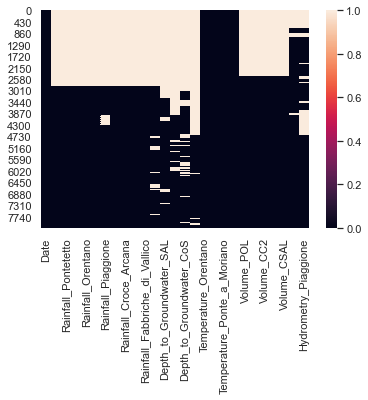

In [7]:
sns.heatmap(df.isna())

In [12]:
for column in train.columns:
    print(column, train[column].dropna().index.min(), train[column].dropna().index.max())

rf_Ga 2006-01-01 00:00:00 2019-12-06 00:00:00
rf_Po 2006-01-01 00:00:00 2019-12-06 00:00:00
rf_MS 2006-01-01 00:00:00 2019-12-06 00:00:00
rf_Or 2006-01-01 00:00:00 2019-12-06 00:00:00
rf_BM 2006-01-01 00:00:00 2019-12-06 00:00:00
rf_Pa 2006-01-01 00:00:00 2019-12-06 00:00:00
rf_Ca 2006-01-01 00:00:00 2019-12-06 00:00:00
rf_Cr 2006-01-01 00:00:00 2019-12-06 00:00:00
rf_TCA 2006-01-01 00:00:00 2019-12-06 00:00:00
rf_FV 2006-01-01 00:00:00 2019-12-06 00:00:00
dtG_LT2 2006-01-01 00:00:00 2019-12-06 00:00:00
dtG_SAL 2007-01-05 00:00:00 2019-12-06 00:00:00
dtG_PAG 2009-01-01 00:00:00 2019-12-06 00:00:00
dtG_CoS 2006-01-07 00:00:00 2019-12-06 00:00:00
dtG_DIEC 2011-01-02 00:00:00 2019-12-06 00:00:00
T_Or 1998-01-04 00:00:00 2019-12-06 00:00:00
T_MS 1998-01-04 00:00:00 2019-12-06 00:00:00
T_PM 1998-01-04 00:00:00 2019-12-06 00:00:00
T_LOB 1998-01-04 00:00:00 2019-12-06 00:00:00
V_POL 2005-01-01 00:00:00 2019-12-06 00:00:00
V_CC1 2005-01-01 00:00:00 2019-12-06 00:00:00
V_CC2 2005-01-01 00:00:00

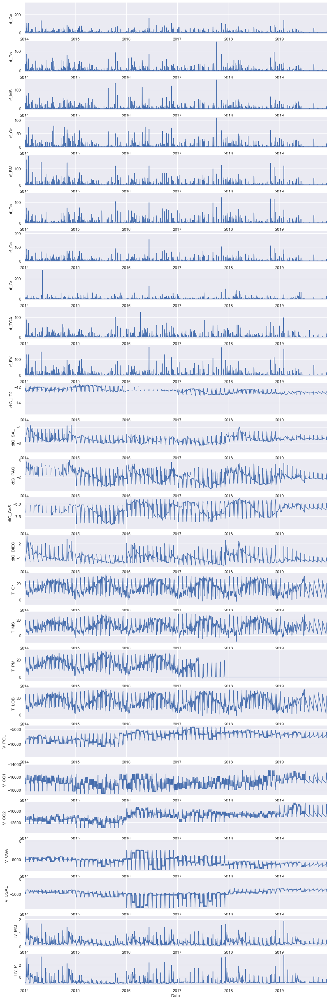

In [37]:
f, ax = plt.subplots(nrows=len(train.columns), ncols=1, figsize=(15, 50))

for element in enumerate(train.columns):
    sns.lineplot(x=train.index, y=train[element[1]], data=train, ax=ax[element[0]])
    ax[element[0]].set_xlim([date(2014, 1, 1), train.index.max()])

plt.show()

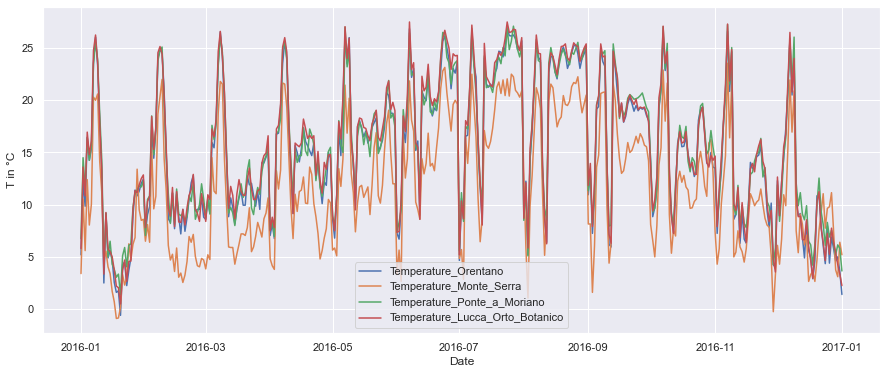

In [50]:
# Temperature logger seem to be faulty - removal of outliers and interpolation
plt.figure(figsize=(15,6))
subset = train.loc['2016-01-01':'2017-01-01']
sns.lineplot(x=subset.index, y=subset['T_Or'], markers=True, label='Temperature_Orentano')
sns.lineplot(x=subset.index, y=subset['T_MS'], markers=True, label='Temperature_Monte_Serra')
sns.lineplot(x=subset.index, y=subset['T_PM'], markers=True, label='Temperature_Ponte_a_Moriano')
sns.lineplot(x=subset.index, y=subset['T_LOB'], markers=True, label='Temperature_Lucca_Orto_Botanico')
plt.ylabel('T in °C')
plt.legend()
plt.show()

In [47]:
subset.groupby(subset.index.day)['T_Or'].agg([np.mean, np.std])

,mean,std
Date,,
1,5.981250,3.883208
2,6.964583,2.182065
3,9.420833,2.937757
4,12.212500,1.520959
5,15.685417,2.882009
6,21.256250,1.594782
7,24.592308,0.960435
8,27.241667,1.183760
9,21.975000,1.633109
